In [1]:
import pymongo
import csv
from datetime import datetime

client = pymongo.MongoClient("mongodb://127.0.0.1:27017/")
db = client["uptake"]
collection = db["uptakes"]

timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
filename = f"uptakes_{timestamp}.csv"

with open(filename, 'w', newline='', encoding='utf-8') as csvfile:
    writer = csv.writer(csvfile)
    
    writer.writerow(["familyId", "lat", "lon", "composition", "ean", "dateTime", "quantity", "mouvementType"])
    
    for doc in collection.find():
        writer.writerow([
            doc["family"]["familyId"],
            doc["family"]["coords"]["lat"],
            doc["family"]["coords"]["lon"],
            doc["family"]["composition"],
            doc["ean"],
            doc["dateTime"],
            doc["quantity"],
            doc["mouvementType"]
        ])

print(f"Exportation terminée. Fichier CSV sauvegardé sous : {filename}")

client.close()

Exportation terminée. Fichier CSV sauvegardé sous : uptakes_20240911_172043.csv


In [2]:
import csv
from datetime import datetime

def get_valid_codebars(categories_file):
    valid_codebars = set()
    with open(categories_file, 'r', newline='', encoding='utf-8') as csvfile:
        reader = csv.DictReader(csvfile)
        for row in reader:
            valid_codebars.add(row['codebar'])
    return valid_codebars

def filter_uptakes(uptakes_file, valid_codebars, output_file):
    with open(uptakes_file, 'r', newline='', encoding='utf-8') as infile, \
         open(output_file, 'w', newline='', encoding='utf-8') as outfile:
        reader = csv.DictReader(infile)
        fieldnames = reader.fieldnames
        writer = csv.DictWriter(outfile, fieldnames=fieldnames)
        
        writer.writeheader()
        for row in reader:
            if row['ean'] in valid_codebars:
                writer.writerow(row)

categories_file = 'predicted_categories_20240911_154100.csv'
uptakes_file = 'uptakes_20240911_154219.csv'

timestamp = datetime.now().strftime("%Y%m%d_%H%M%S")
output_file = f'filtered_uptakes_{timestamp}.csv'

valid_codebars = get_valid_codebars(categories_file)

filter_uptakes(uptakes_file, valid_codebars, output_file)

print(f"Filtrage terminé. Nouveau fichier CSV sauvegardé sous : {output_file}")

Filtrage terminé. Nouveau fichier CSV sauvegardé sous : filtered_uptakes_20240911_172050.csv


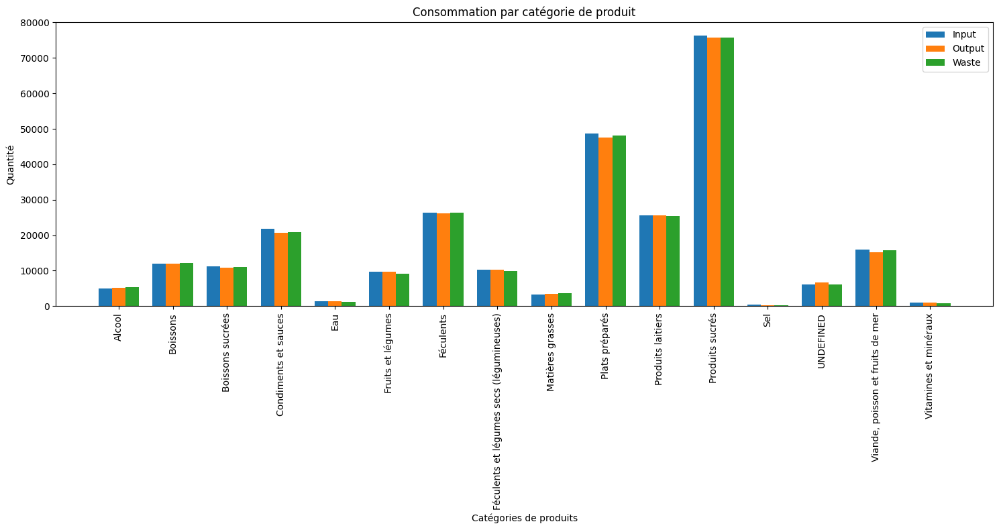

In [1]:
import pandas as pd
import matplotlib.pyplot as plt

uptakes = pd.read_csv('filtered_uptakes_20240911_154826.csv')
categories = pd.read_csv('predicted_categories_20240911_154100.csv')

uptakes['ean'] = uptakes['ean'].astype(str)
categories['codebar'] = categories['codebar'].astype(str)
merged_data = pd.merge(uptakes, categories, left_on='ean', right_on='codebar', how='left')

category_mapping = {
    "Alcool": 0, "Boissons": 1, "Boissons sucrées": 2, "Condiments et sauces": 3,
    "Eau": 4, "Fruits et légumes": 5, "Féculents": 6,
    "Féculents et légumes secs (légumineuses)": 7, "Matières grasses": 8,
    "Plats préparés": 9, "Produits laitiers": 10, "Produits sucrés": 11,
    "Sel": 12, "UNDEFINED": 13, "Viande, poisson et fruits de mer": 14,
    "Vitamines et minéraux": 15
}

merged_data['category_id'] = merged_data['predicted_category'].map(category_mapping)

input_data = merged_data[merged_data['mouvementType'] == 'input'].groupby('predicted_category')['quantity'].sum()
output_data = merged_data[merged_data['mouvementType'] == 'output'].groupby('predicted_category')['quantity'].sum()
waste_data = merged_data[merged_data['mouvementType'] == 'waste'].groupby('predicted_category')['quantity'].sum()

fig, ax = plt.subplots(figsize=(15, 8))

bar_width = 0.25
r1 = range(len(category_mapping))
r2 = [x + bar_width for x in r1]
r3 = [x + bar_width for x in r2]

input_color = '#1f77b4'
output_color = '#ff7f0e'
waste_color = '#2ca02c'

plt.bar(r1, input_data, color=input_color, width=bar_width, label='Input')
plt.bar(r2, output_data, color=output_color, width=bar_width, label='Output')
plt.bar(r3, waste_data, color=waste_color, width=bar_width, label='Waste')

plt.xlabel('Catégories de produits')
plt.ylabel('Quantité')
plt.title('Consommation par catégorie de produit')
plt.xticks([r + bar_width for r in range(len(category_mapping))], category_mapping.keys(), rotation=90)

plt.legend()

plt.tight_layout()
plt.show()

In [4]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

merged_data['dateTime'] = pd.to_datetime(merged_data['dateTime'])

fig = go.Figure()

for category in merged_data['predicted_category'].unique():
    category_data = merged_data[(merged_data['predicted_category'] == category) & (merged_data['mouvementType'] == 'input')]
    category_data = category_data.set_index('dateTime').resample('D')['quantity'].sum().reset_index()
    
    fig.add_trace(go.Scatter(
        x=category_data['dateTime'],
        y=category_data['quantity'],
        name=category,
        mode='lines',
        line=dict(width=2),
        hoverinfo='x+y+name'
    ))

fig.update_layout(
    title='Évolution temporelle de la consommation par catégorie',
    xaxis_title='Date',
    yaxis_title='Quantité consommée',
    legend_title='Catégories',
    hovermode='closest',
    width=1000,
    height=600
)

fig.update_layout(
    updatemenus=[
        dict(
            type="buttons",
            direction="left",
            buttons=list([
                dict(
                    args=[{"visible": [True] * len(fig.data)}],
                    label="Tout afficher",
                    method="restyle"
                ),
                dict(
                    args=[{"visible": [False] * len(fig.data)}],
                    label="Tout masquer",
                    method="restyle"
                )
            ]),
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.11,
            xanchor="left",
            y=1.1,
            yanchor="top"
        ),
    ]
)

fig.show()

In [6]:
import plotly.express as px
import plotly.graph_objects as go

fig = px.scatter_mapbox(
    merged_data, 
    lat="lat", 
    lon="lon", 
    color="predicted_category", 
    size="quantity",
    hover_name="product_name",
    hover_data=["dateTime", "mouvementType", "quantity"],
    zoom=5,
    mapbox_style="open-street-map",
    title="Carte des mouvements de produits par catégorie",
    opacity=0.5,
    size_max=5
)

for trace in fig.data:
    trace.visible = 'legendonly'

fig.show()


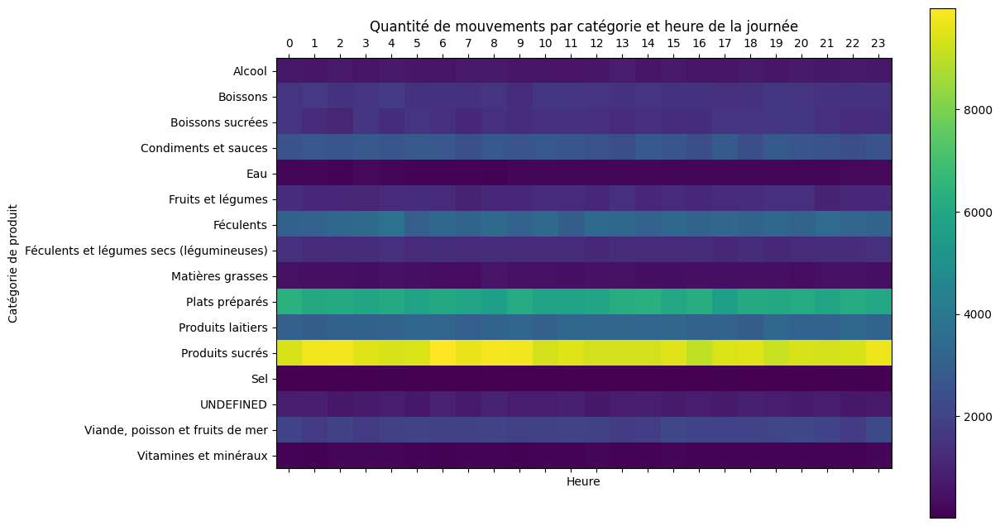

In [11]:
import numpy as np

merged_data['hour'] = merged_data['dateTime'].dt.hour

heatmap_data = merged_data.pivot_table(
    index='predicted_category', 
    columns='hour', 
    values='quantity', 
    aggfunc='sum',
    fill_value=0
)

fig, ax = plt.subplots(figsize=(12, 8))
cax = ax.matshow(heatmap_data, cmap='viridis')

ax.set_xticks(np.arange(len(heatmap_data.columns)))
ax.set_yticks(np.arange(len(heatmap_data.index)))
ax.set_xticklabels(heatmap_data.columns)
ax.set_yticklabels(heatmap_data.index)

plt.colorbar(cax)
plt.title('Quantité de mouvements par catégorie et heure de la journée')
plt.xlabel('Heure')
plt.ylabel('Catégorie de produit')
plt.show()


In [ ]:
# import plotly.graph_objects as go

# sankey_data = merged_data.groupby(['familyId', 'mouvementType'])['quantity'].sum().reset_index()

# fig = go.Figure(go.Sankey(
#     node = dict(
#         pad = 15,
#         thickness = 20,
#         line = dict(color = "black", width = 0.5),
#         label = sankey_data['familyId'].astype(str).tolist() + sankey_data['mouvementType'].unique().tolist(),
#     ),
#     link = dict(
#         source = sankey_data['familyId'].astype(str).tolist(),
#         target = sankey_data['mouvementType'].astype(str).tolist(),
#         value = sankey_data['quantity'].tolist(),
#     )))

# fig.update_layout(title_text="Flux des produits entre familles et types de mouvements", font_size=10)
# fig.show()
